# Grid of the brightfield samples all together and Masks

This code used the preprocessed file and combine all the samples in a big grid to have a clear picture of the bi grid.

**Note:** set has maks to TRUE if we want print masks grids, addionaly the masks just have focal point z=6.

In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import torchvision
from torchvision import transforms
from PIL import Image

# Load the DataFrame
def load_dataframe_from_csv(file_path):
    df = pd.read_csv(file_path, delimiter=';')
    return df

# Function to filter images by well and z-position
def filter_images(df, well_number, z_position, has_mask=False):
    filtered_df = df[(df['well_number'] == well_number) & (df['z_position'] == z_position) & (df['has_mask'] == has_mask)]
    return filtered_df

# Function to create a black image
def create_black_image(size=(256, 256)):
    return Image.new('RGB', size, (0, 0, 0))

# Function to create grids for each z-position
def create_grids(df, well_number, z_position, transform, has_mask=False):
    all_images = []
    filtered_df = filter_images(df, well_number, z_position, has_mask)
    sample_numbers = filtered_df['sample_site'].unique()  # Get unique sample numbers

    for sample_number in sample_numbers:
        sample_path = filtered_df[filtered_df['sample_site'] == sample_number]['path'].values
        if len(sample_path) > 0:
            image = Image.open(sample_path[0])
            all_images.append(transform(image))
        else:
            # Add black image for missing samples
            black_image = create_black_image()
            all_images.append(transform(black_image))

    # Check if any images were added
    if not all_images:
        print(f"No images found for well {well_number} and z_position {z_position}.")
    else:
        # Determine the number of rows based on the well number
        well_rows = {
            'well1': 13,
            'well2': 14,
            'well3': 14,
            'well4': 15,
            'well5': 15,
            'well6': 15,
            'well7': 15
        }
        nrow = well_rows.get(well_number, 14)  # Default to 14 if well number is not in the dictionary

        # Create a grid of images
        grid_img = torchvision.utils.make_grid(all_images, nrow=nrow)
        plt.figure(figsize=(20, 20))  # Adjust figure size as needed
        plt.imshow(grid_img.permute(1, 2, 0))
        plt.axis('off')
        plt.title(f"Grid for well {well_number} and z_position {z_position}")
        plt.show()

# Example usage
file_path = "./data/filename_data.csv"
loaded_df = load_dataframe_from_csv(file_path)
transform = transforms.Compose([transforms.ToTensor()])  # Example transform

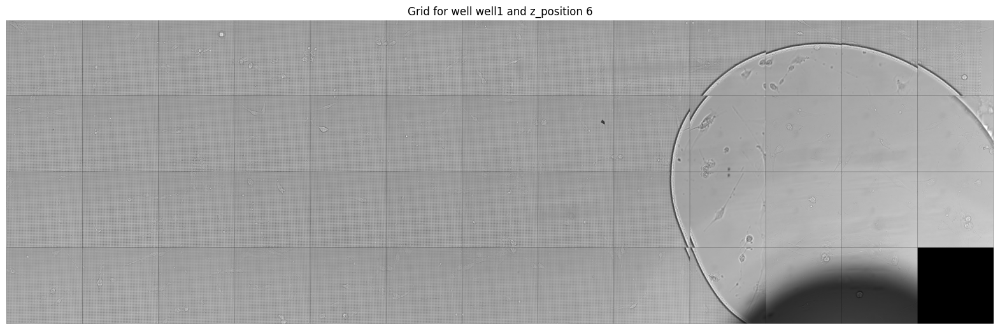

In [2]:
# Create grids for well1 and z_position 
create_grids(loaded_df, 'well1', 6, transform, False)

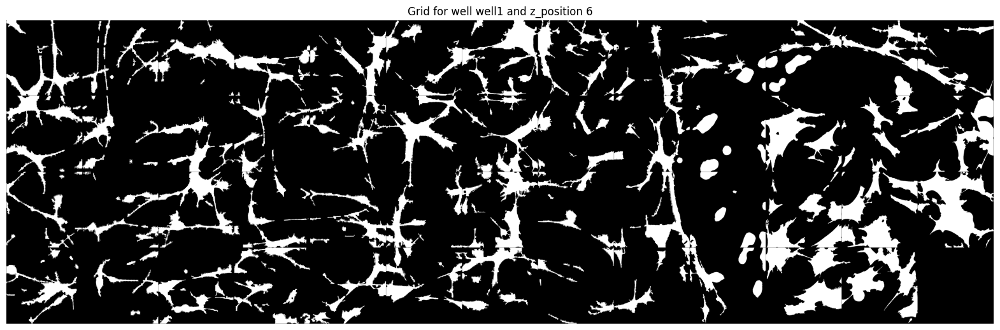

In [3]:
create_grids(loaded_df, 'well1', 6, transform, True)

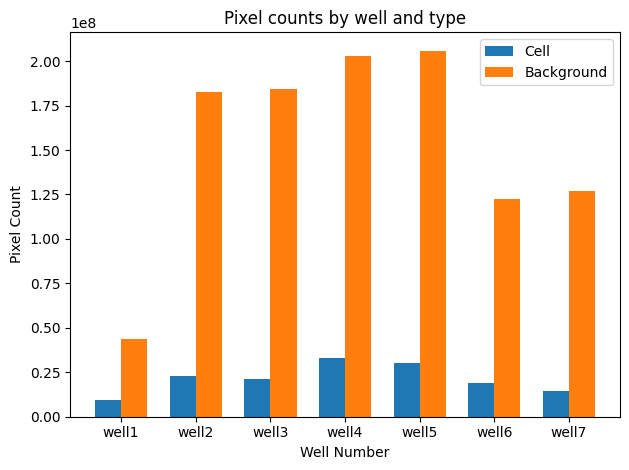

In [5]:
import pandas as pd
import os
import torch
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

def load_mask(mask_path):
    """Load a mask image and convert it to a tensor."""
    mask = Image.open(mask_path).convert('L')  # Convert to grayscale
    mask = np.array(mask)
    return torch.tensor(mask)

def count_pixels(mask_paths, cell_value=255, background_value=0):
    """Count the number of cell and background pixels in the given mask paths."""
    cell_count = 0
    background_count = 0

    for mask_path in mask_paths:
        mask = load_mask(mask_path)
        cell_count += (mask == cell_value).sum().item()
        background_count += (mask == background_value).sum().item()

    return cell_count, background_count

# Load the CSV file
file_path = "./data/filename_data.csv"
df = pd.read_csv(file_path, sep=';')

# Filter rows where has_mask is True
df = df[df['has_mask'] == True]

# Group by well and count pixels
well_counts = {}
for well, group in df.groupby('well_number'):
    mask_paths = group['path'].tolist()
    cell_count, background_count = count_pixels(mask_paths)
    well_counts[well] = {'cell': cell_count, 'background': background_count}

# Plot the results
wells = list(well_counts.keys())
cell_counts = [well_counts[well]['cell'] for well in wells]
background_counts = [well_counts[well]['background'] for well in wells]

x = np.arange(len(wells))  # the label locations
width = 0.35  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x - width/2, cell_counts, width, label='Cell')
rects2 = ax.bar(x + width/2, background_counts, width, label='Background')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_xlabel('Well Number')
ax.set_ylabel('Pixel Count')
ax.set_title('Pixel counts by well and type')
ax.set_xticks(x)
ax.set_xticklabels(wells)
ax.legend()

fig.tight_layout()

plt.show()

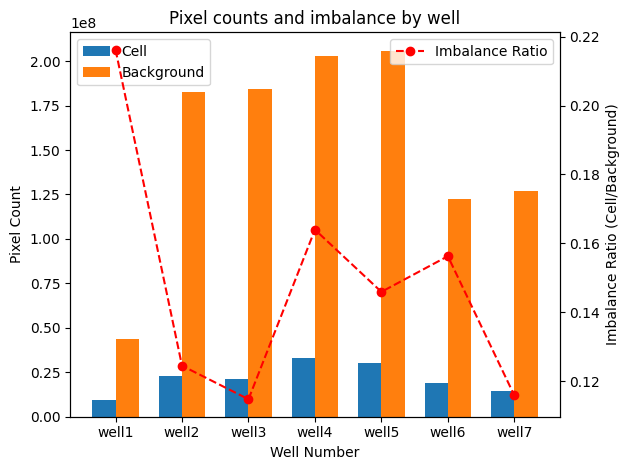

In [6]:
import pandas as pd
import os
import torch
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

def load_mask(mask_path):
    """Load a mask image and convert it to a tensor."""
    mask = Image.open(mask_path).convert('L')  # Convert to grayscale
    mask = np.array(mask)
    return torch.tensor(mask)

def count_pixels(mask_paths, cell_value=255, background_value=0):
    """Count the number of cell and background pixels in the given mask paths."""
    cell_count = 0
    background_count = 0

    for mask_path in mask_paths:
        mask = load_mask(mask_path)
        cell_count += (mask == cell_value).sum().item()
        background_count += (mask == background_value).sum().item()

    return cell_count, background_count

# Load the CSV file
file_path = "./data/filename_data.csv"
df = pd.read_csv(file_path, sep=';')

# Filter rows where has_mask is True
df = df[df['has_mask'] == True]

# Group by well and count pixels
well_counts = {}
for well, group in df.groupby('well_number'):
    mask_paths = group['path'].tolist()
    cell_count, background_count = count_pixels(mask_paths)
    imbalance = cell_count / background_count if background_count != 0 else float('inf')
    well_counts[well] = {'cell': cell_count, 'background': background_count, 'imbalance': imbalance}

# Plot the results
wells = list(well_counts.keys())
cell_counts = [well_counts[well]['cell'] for well in wells]
background_counts = [well_counts[well]['background'] for well in wells]
imbalances = [well_counts[well]['imbalance'] for well in wells]

x = np.arange(len(wells))  # the label locations
width = 0.35  # the width of the bars

fig, ax1 = plt.subplots()

# Plot cell and background counts
rects1 = ax1.bar(x - width/2, cell_counts, width, label='Cell')
rects2 = ax1.bar(x + width/2, background_counts, width, label='Background')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax1.set_xlabel('Well Number')
ax1.set_ylabel('Pixel Count')
ax1.set_title('Pixel counts and imbalance by well')
ax1.set_xticks(x)
ax1.set_xticklabels(wells)
ax1.legend(loc='upper left')

# Create a second y-axis for the imbalance ratio
ax2 = ax1.twinx()
ax2.set_ylabel('Imbalance Ratio (Cell/Background)')
ax2.plot(x, imbalances, color='red', marker='o', linestyle='dashed', label='Imbalance Ratio')
ax2.legend(loc='upper right')

fig.tight_layout()

plt.show()

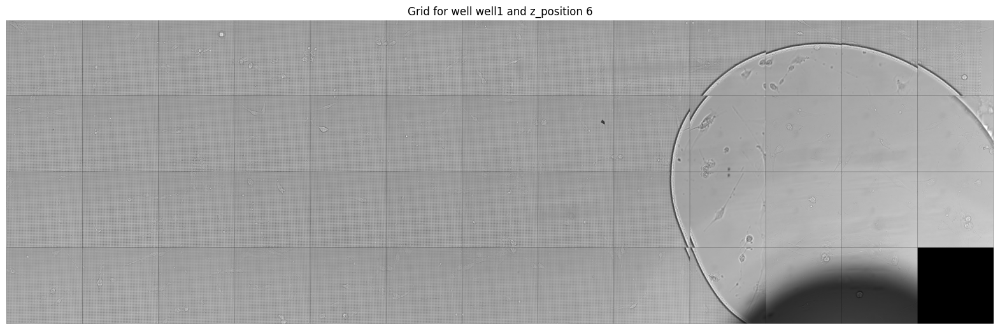

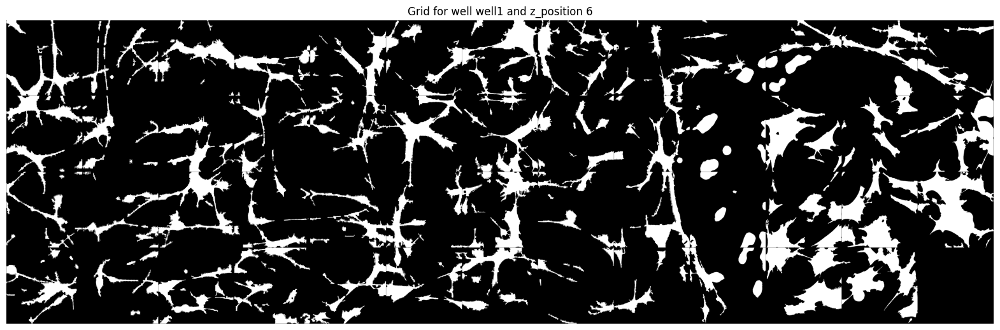

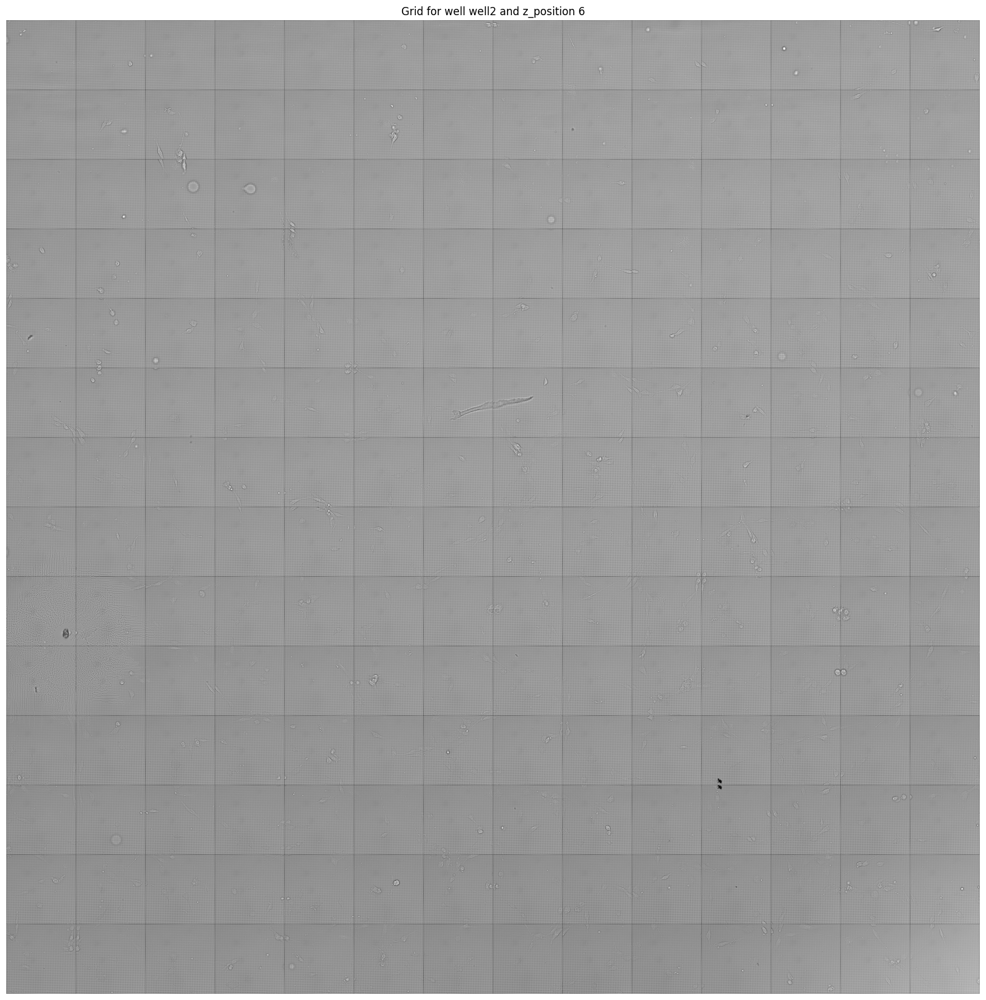

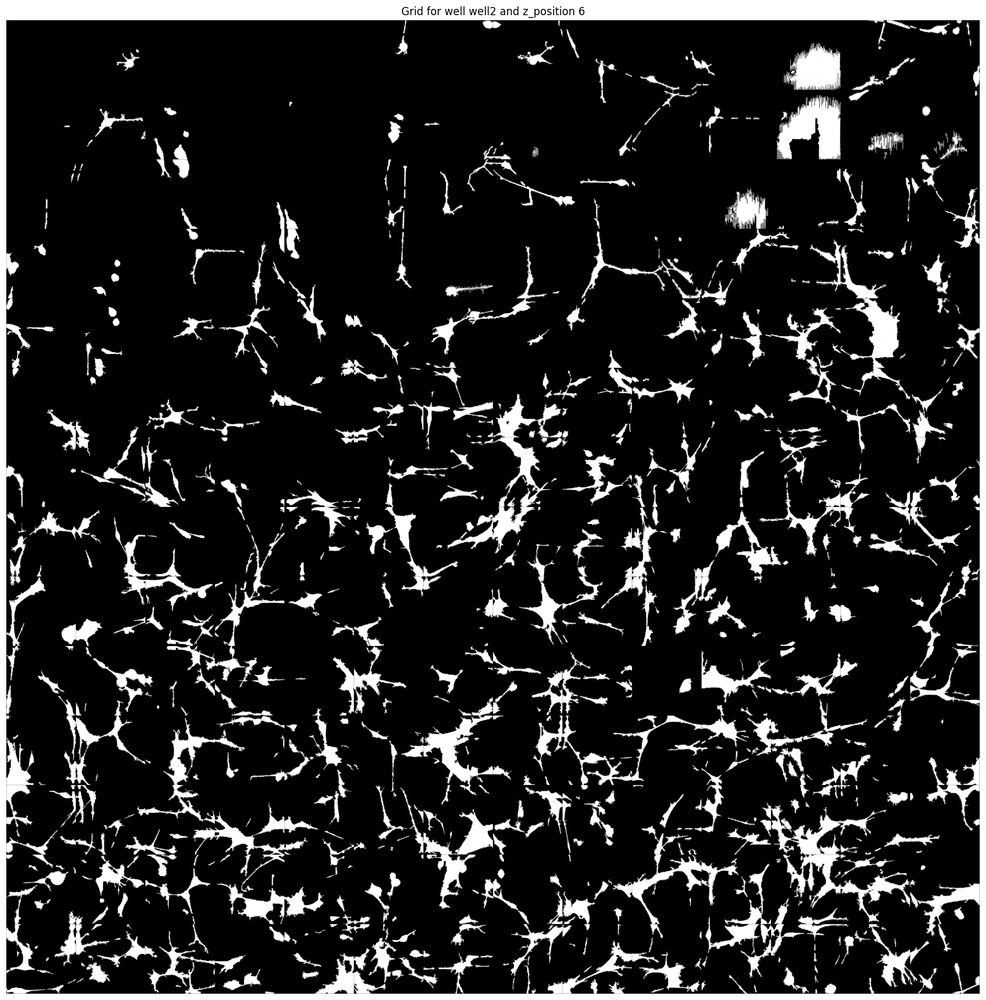

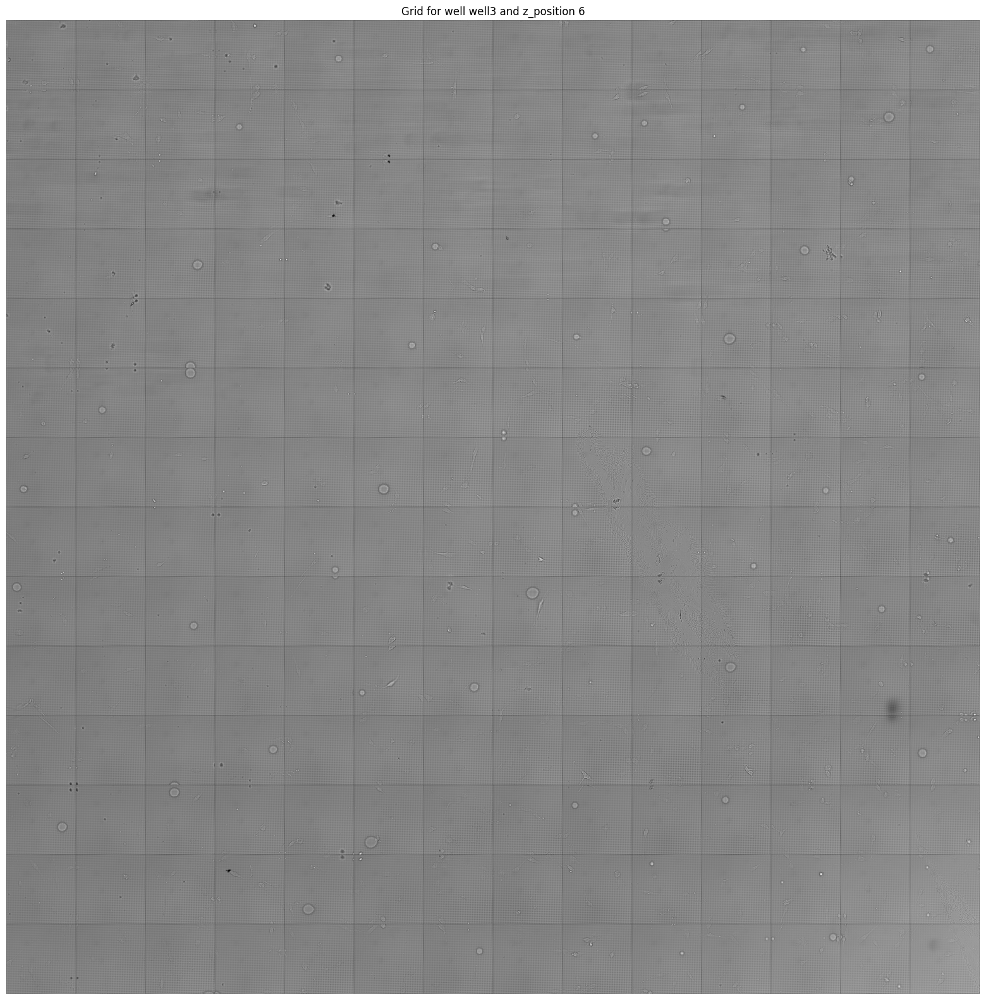

...

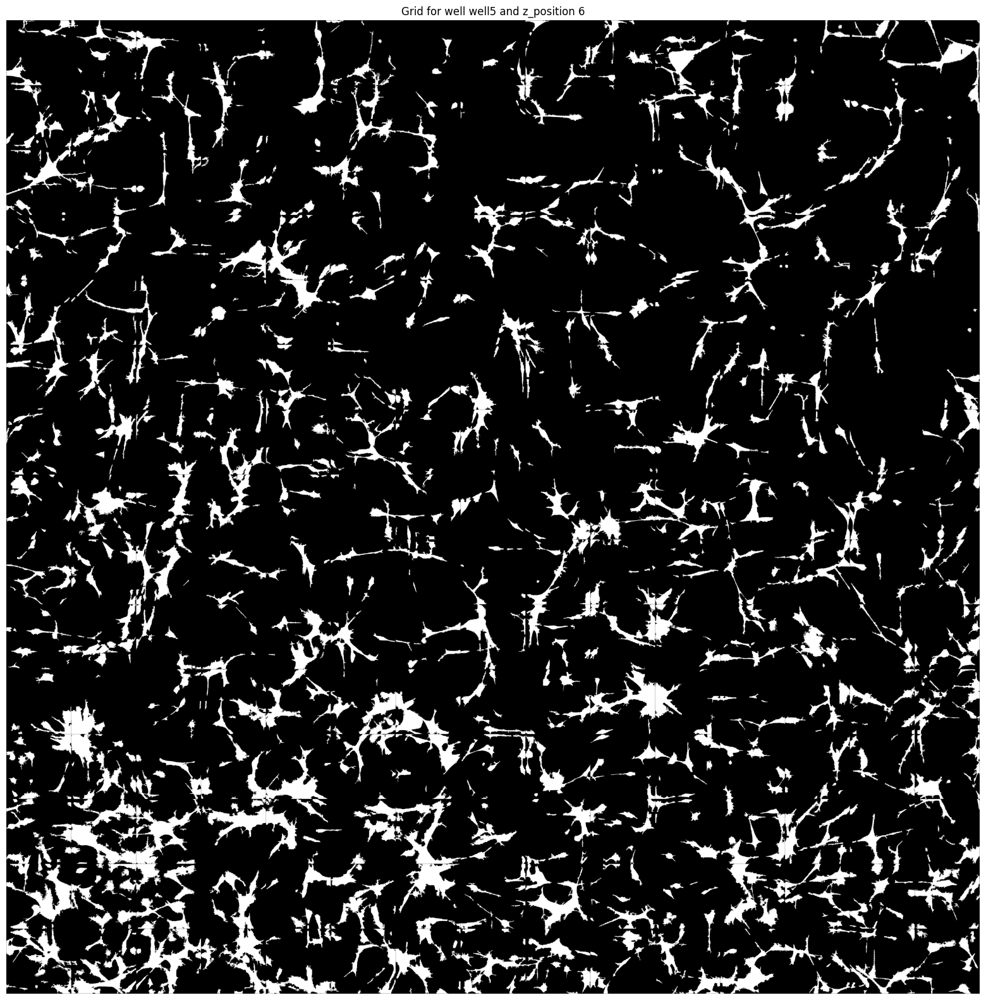

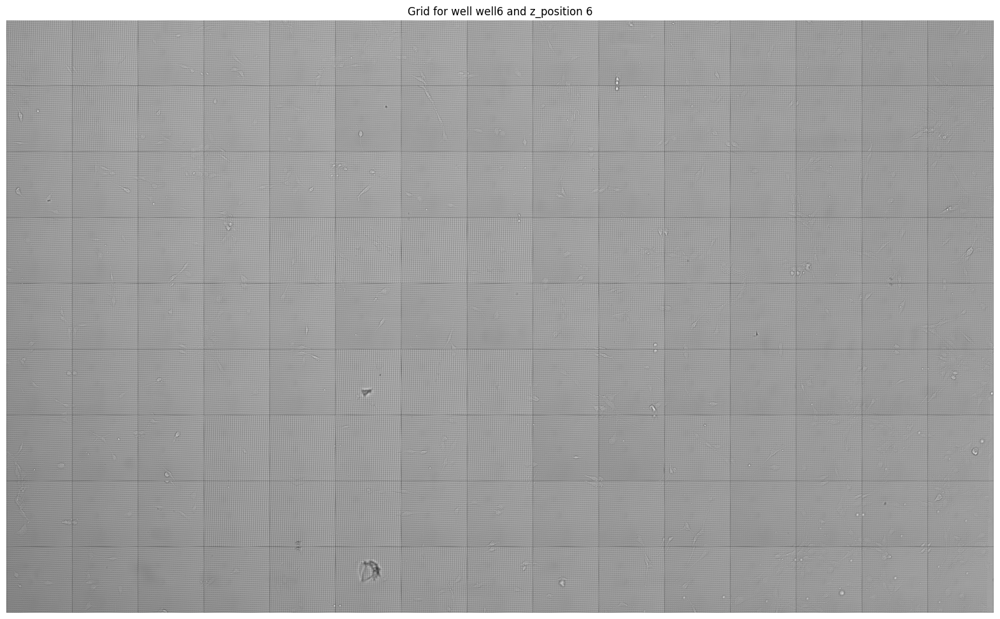

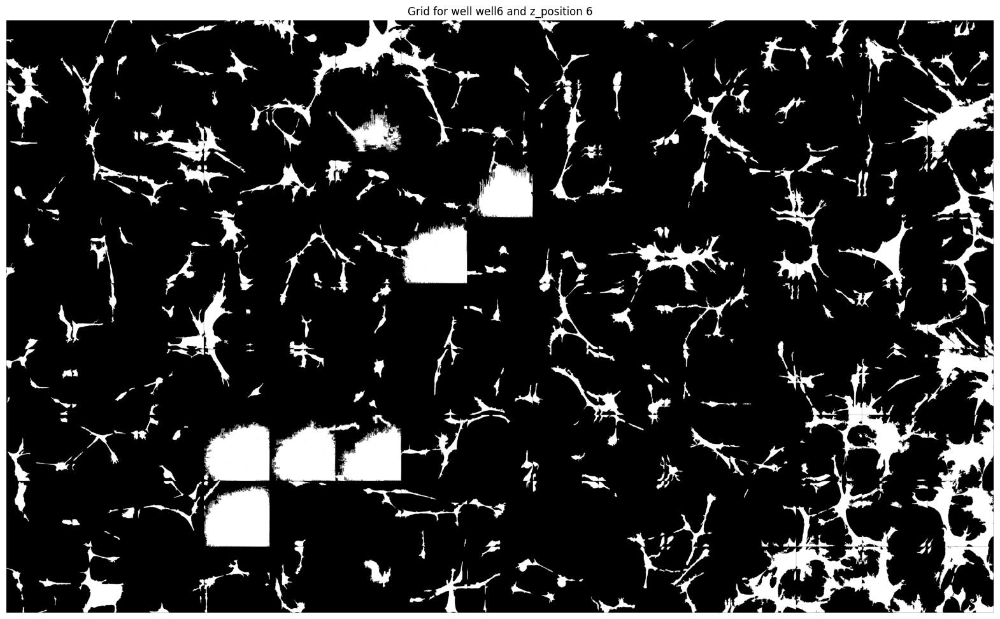

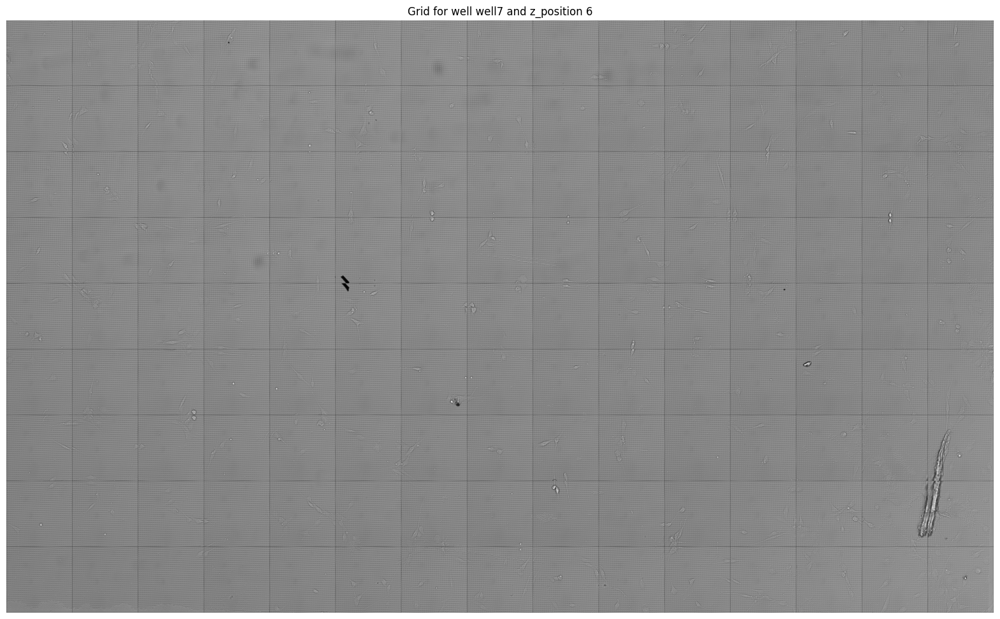

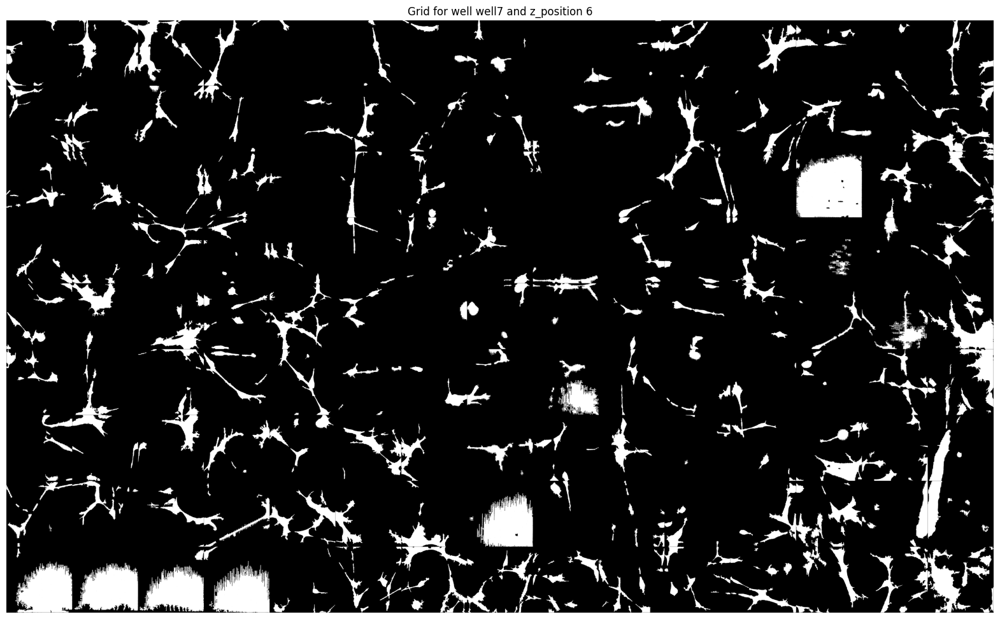

In [2]:
# create a grid for all weells in z_position 6 with mask
for well in ['well1', 'well2', 'well3', 'well4', 'well5', 'well6', 'well7']:
    create_grids(loaded_df, well, 6, transform, False)
    create_grids(loaded_df, well, 6, transform, True)